Entrenamiento de los 2 agentes

In [1]:
import numpy as np
import pickle
import random
import matplotlib.pyplot as plt
from collections import defaultdict, deque

class Ambiente:
    def __init__(self):
        self.rows = 6
        self.columns = 7
        self.reset()

    def reset(self):
        self.board = np.zeros((self.rows, self.columns))
        self.turn = 1
        self.moves_made = 0
        self.done = False

    def is_valid_move(self, column):
        return self.board[0][column] == 0

    def get_valid_moves(self):
        return [col for col in range(self.columns) if self.is_valid_move(col)]

    def play_move(self, column):
        if not self.is_valid_move(column):
            return False
        for row in range(self.rows - 1, -1, -1):
            if self.board[row][column] == 0:
                self.board[row][column] = self.turn
                self.moves_made += 1
                break
        return True

    def switch_turn(self):
        self.turn *= -1

    def check_winner(self):
        for c in range(self.columns - 3):
            for r in range(self.rows):
                if np.abs(np.sum(self.board[r, c:c + 4])) == 4:
                    return True
        for c in range(self.columns):
            for r in range(self.rows - 3):
                if np.abs(np.sum(self.board[r:r + 4, c])) == 4:
                    return True
        for c in range(self.columns - 3):
            for r in range(self.rows - 3):
                if np.abs(np.sum([self.board[r + i, c + i] for i in range(4)])) == 4:
                    return True
                if np.abs(np.sum([self.board[r + 3 - i, c + i] for i in range(4)])) == 4:
                    return True
        return False

    def is_draw(self):
        return self.moves_made == self.rows * self.columns

    def mirror_board(self):
        return tuple(map(tuple, np.fliplr(self.board)))

    def flip_vertical(self):
        return tuple(map(tuple, np.flipud(self.board)))

    def get_partial_view(self):
        # Returns a partial view focusing around the last move (or central columns)
        return tuple(map(tuple, self.board[:, 2:5]))

class Agente:
    def __init__(self, gamma=0.95, lr=0.01):
        self.q_table = {}
        self.gamma = gamma
        self.lr = lr
        self.epsilon = 1.0
        self.epsilon_decay = 0.999
        self.epsilon_min = 0.1
        self.experience_replay = deque(maxlen=2000)
        self.group_visit_counts = defaultdict(int)

    def get_state(self, env):
        return tuple(map(tuple, env.board))

    def choose_action(self, env):
        state = self.get_state(env)
        if state not in self.q_table:
            self.q_table[state] = [0] * env.columns
        if random.uniform(0, 1) < self.epsilon:
            return random.choice(env.get_valid_moves())
        else:
            return self.get_best_action(state, env)

    def get_best_action(self, state, env):
        valid_moves = env.get_valid_moves()
        q_values = np.array(self.q_table[state], dtype=float)
        q_values_invalid = [i for i in range(env.columns) if i not in valid_moves]
        q_values[q_values_invalid] = -1e6
        return np.argmax(q_values)

    def update_q_value(self, state, action, reward, next_state):
        if next_state not in self.q_table:
            self.q_table[next_state] = [0] * env.columns
        max_future_q = max(self.q_table[next_state])
        current_q = self.q_table[state][action]
        self.q_table[state][action] = current_q + self.lr * (reward + self.gamma * max_future_q - current_q)

    def store_experience(self, state, action, reward, next_state):
        self.experience_replay.append((state, action, reward, next_state))

    def replay_experience(self):
        if len(self.experience_replay) > 32:
            minibatch = random.sample(self.experience_replay, 32)
            for state, action, reward, next_state in minibatch:
                self.update_q_value(state, action, reward, next_state)

    def update_group_visit_counts(self, env):
        for row in range(env.rows):
            for col in range(env.columns - 1):
                group = tuple(env.board[row, col:col + 2])
                self.group_visit_counts[group] += 1
        for col in range(env.columns):
            for row in range(env.rows - 1):
                group = tuple(env.board[row:row + 2, col])
                self.group_visit_counts[group] += 1

    def save_q_table(self, file_name):
        with open(file_name, 'wb') as f:
            pickle.dump(self.q_table, f)

def jugar_partida(agente_rojo, agente_amarillo, env):
    env.reset()
    agentes = [agente_rojo, agente_amarillo]
    turno = 0
    state_action_history = []

    while not env.done:
        agente_actual = agentes[turno]
        state = agente_actual.get_state(env)
        action = agente_actual.choose_action(env)
        state_action_history.append((state, action, turno))

        env.play_move(action)
        next_state = agente_actual.get_state(env)

        if env.check_winner():
            for s, a, t in reversed(state_action_history):
                reward = 10 if t == turno else -10
                agentes[t].update_q_value(s, a, reward, next_state)
                agentes[t].store_experience(s, a, reward, next_state)
            env.done = True
            agente_actual.update_group_visit_counts(env)
            return 1 if turno == 0 else -1
        elif env.is_draw():
            for s, a, t in reversed(state_action_history):
                agentes[t].update_q_value(s, a, 5, next_state)
                agentes[t].store_experience(s, a, 5, next_state)
            env.done = True
            agente_actual.update_group_visit_counts(env)
            return 0
        else:
            agentes[turno].update_q_value(state, action, 0, next_state)
            agentes[turno].store_experience(state, action, 0, next_state)

        env.switch_turn()
        turno = 1 - turno

    # Data augmentation with mirrored and vertically flipped boards
    for s, a, t in reversed(state_action_history):
        mirrored_state = env.mirror_board()
        flipped_state = env.flip_vertical()
        partial_state = env.get_partial_view()

        agentes[t].update_q_value(mirrored_state, a, reward, mirrored_state)
        agentes[t].update_q_value(flipped_state, a, reward, flipped_state)
        agentes[t].update_q_value(partial_state, a, reward, partial_state)

    # Experience replay for improved learning
    agente_rojo.replay_experience()
    agente_amarillo.replay_experience()

if __name__ == "__main__":
    env = Ambiente()
    agente_rojo = Agente()
    agente_amarillo = Agente()

    partidas = 20000
    resultados = []

    for i in range(partidas):
        resultado = jugar_partida(agente_rojo, agente_amarillo, env)
        resultados.append(resultado)
        agente_rojo.epsilon = max(agente_rojo.epsilon * agente_rojo.epsilon_decay, agente_rojo.epsilon_min)
        agente_amarillo.epsilon = max(agente_amarillo.epsilon * agente_amarillo.epsilon_decay, agente_amarillo.epsilon_min)
        if (i+1) % 100 == 0:
            print(f"Partida {i+1}/{partidas} completada.")

    agente_rojo.save_q_table("q_table_rojo.pkl")
    agente_amarillo.save_q_table("q_table_amarillo.pkl")


Partida 100/20000 completada.
Partida 200/20000 completada.
Partida 300/20000 completada.


KeyboardInterrupt: 

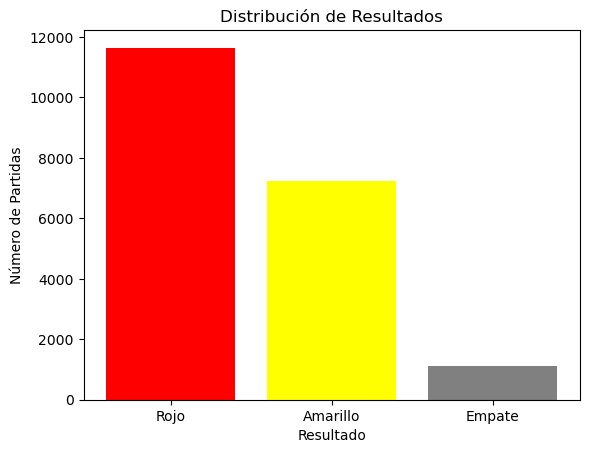

In [7]:
import matplotlib.pyplot as plt

# Contar y graficar resultados
victorias_rojo = resultados.count(1)
victorias_amarillo = resultados.count(-1)
empates = resultados.count(0)
# Crear gráfico de barras
labels = ['Rojo', 'Amarillo', 'Empate']
values = [victorias_rojo, victorias_amarillo, empates]
plt.bar(labels, values, color=['red', 'yellow', 'gray'])
plt.title('Distribución de Resultados')
plt.xlabel('Resultado')
plt.ylabel('Número de Partidas')
plt.show()

In [9]:
import pickle

# Cargar el archivo .pkl
with open('q_table_rojo.pkl', 'rb') as file:
    data = pickle.load(file)

# Mostrar el contenido del archivo
print(data)

{((0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0)): [0.17433828545292135, -0.7217832090271404, -0.5910625525483334, 2.282769654945346, 0.2635347332587843, 0.26546896716091634, -0.9321743306699782], ((0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0)): [0, 0, 0, 0, 0, 0, 0], ((0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0), (0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0)): [-0.05766844650181155, 0.007802384059899983, 0.08447208538289201, -0.19801000000000002, 0.8438227299396749, 0.026210474304945178, -0.1], ((0.0, 0.0, 0.0, 0.0

In [2]:
print("Número de estados en la Q-table:", len(agente_rojo.q_table))

Número de estados en la Q-table: 318512


In [ ]:
import tkinter as tk
import numpy as np
import pickle
import random
from tkinter import messagebox

class Ambiente:
    def __init__(self):
        self.rows = 6
        self.columns = 7
        self.reset()

    def reset(self):
        self.board = np.zeros((self.rows, self.columns))
        self.turn = 1
        self.moves_made = 0
        self.done = False

    def is_valid_move(self, column):
        return self.board[0][column] == 0

    def get_valid_moves(self):
        return [col for col in range(self.columns) if self.is_valid_move(col)]

    def play_move(self, column):
        if not self.is_valid_move(column):
            return False
        for row in range(self.rows - 1, -1, -1):
            if self.board[row][column] == 0:
                self.board[row][column] = self.turn
                self.moves_made += 1
                break
        return True

    def switch_turn(self):
        self.turn *= -1

    def check_winner(self):
        for c in range(self.columns - 3):
            for r in range(self.rows):
                if np.abs(np.sum(self.board[r, c:c + 4])) == 4:
                    return True
        for c in range(self.columns):
            for r in range(self.rows - 3):
                if np.abs(np.sum(self.board[r:r + 4, c])) == 4:
                    return True
        for c in range(self.columns - 3):
            for r in range(self.rows - 3):
                if np.abs(np.sum([self.board[r + i, c + i] for i in range(4)])) == 4:
                    return True
                if np.abs(np.sum([self.board[r + 3 - i, c + i] for i in range(4)])) == 4:
                    return True
        return False

    def is_draw(self):
        return self.moves_made == self.rows * self.columns

class Agente:
    def __init__(self, epsilon=0.05):
        self.q_table = {}
        self.epsilon = epsilon

    def load_q_table(self, file_name):
        with open(file_name, 'rb') as f:
            self.q_table = pickle.load(f)

    def get_state(self, env):
        return tuple(map(tuple, env.board))

    def choose_action(self, env):
        state = self.get_state(env)
        if random.uniform(0, 1) < self.epsilon:
            return random.choice(env.get_valid_moves())
        elif state in self.q_table:
            return self.get_best_action(state, env)
        else:
            return random.choice(env.get_valid_moves())

    def get_best_action(self, state, env):
        valid_moves = env.get_valid_moves()
        q_values = np.array(self.q_table.get(state, [0] * env.columns))
        q_values[~np.isin(range(env.columns), valid_moves)] = -1e6
        return np.argmax(q_values)

class Connect4GUI:
    def __init__(self, env, agente_rojo=None):
        self.env = env
        self.agente_rojo = agente_rojo
        self.turn = "yellow"
        self.window = tk.Tk()
        self.window.title("Conecta 4 - Humano (Amarillo) vs. Agente (Rojo)")

        self.buttons = [
            tk.Button(self.window, text="▼", font=("Arial", 16, "bold"), bg="gold", command=lambda c=i: self.human_move(c))
            for i in range(self.env.columns)
        ]
        for i, button in enumerate(self.buttons):
            button.grid(row=0, column=i, sticky="nsew", padx=2, pady=2)

        self.canvas = tk.Canvas(self.window, width=self.env.columns * 100, height=self.env.rows * 100, bg="#1E90FF")
        self.canvas.grid(row=1, column=0, columnspan=self.env.columns, padx=5, pady=5)
        self.circles = [[self.canvas.create_oval(j * 100 + 10, i * 100 + 10, j * 100 + 90, i * 100 + 90, fill="white") for j in range(self.env.columns)] for i in range(self.env.rows)]

        for i in range(self.env.columns):
            self.window.grid_columnconfigure(i, weight=1)
        self.window.grid_rowconfigure(1, weight=1)

    def disable_buttons(self):
        for button in self.buttons:
            button.config(state=tk.DISABLED)

    def enable_buttons(self):
        for button in self.buttons:
            button.config(state=tk.NORMAL)

    def human_move(self, column):
        if self.turn != "yellow" or not self.env.is_valid_move(column):
            return
        self.execute_move(column, "yellow", "¡Ganaste!")
        self.switch_turn()

    def agent_play(self):
        if self.turn != "red" or not self.agente_rojo:
            return
        action = self.agente_rojo.choose_action(self.env)
        self.execute_move(action, "red", "¡El agente rojo ha ganado!")
        self.switch_turn()

    def execute_move(self, column, color, win_message):
        self.env.play_move(column)
        row = next(r for r in range(self.env.rows) if self.env.board[r][column] != 0)
        self.canvas.itemconfig(self.circles[row][column], fill=color)
        if self.env.check_winner():
            messagebox.showinfo("Fin del juego", win_message)
            self.reset_game()
        elif self.env.is_draw():
            messagebox.showinfo("Fin del juego", "¡Es un empate!")
            self.reset_game()

    def switch_turn(self):
        self.env.switch_turn()
        self.turn = "yellow" if self.turn == "red" else "red"
        if self.turn == "yellow":
            self.enable_buttons()
        else:
            self.disable_buttons()
            self.window.after(500, self.agent_play)

    def reset_game(self):
        self.env.reset()
        self.turn = "yellow"
        for i in range(self.env.rows):
            for j in range(self.env.columns):
                self.canvas.itemconfig(self.circles[i][j], fill="white")
        self.enable_buttons()

    def run(self):
        self.window.mainloop()

if __name__ == "__main__":
    env = Ambiente()
    agente_rojo = Agente()
    agente_rojo.load_q_table("q_table_rojo.pkl")
    gui = Connect4GUI(env, agente_rojo)
    gui.run()


: 